# Exercise 2: Muon stopping power¶

The *stopping power* of a particle usually refers to the energy loss rate $dE/dx$ when it passes through matter. When charged particles travel through our LArTPC detector, they interact with the argon and lose energy.

```{note}
Currently this tutorial only computes dQ/dx distribution. Need refresh to make a 2D plot of dQ/dx vs residual range.
```

## MIP and Bragg peak¶

Minimally ionizing particles (MIP) are charged particles which lose energy when passing through matter at a rate close to minimal. Particles such as muons often have energy losses close to the MIP level and are treated in practice as MIP. The only exception is when the muon comes to a stop and experiences a Bragg peak.

```{figure} ./bragg_peak.png
---
height: 200px
---
Example of muon Bragg peak. The muon is travelling from bottom left to top right. The color scale represents energy deposition. Red means more energy deposited. The sudden increase in deposited (lost) energy towards the end of the muon trajectory is the Bragg peak. From MicroBooNE (arxiv: 1704.02927)
```

## I. Motivation

We know that the energy loss rate of a MIP in argon is ~2 MeV/cm. Hence our goal is to carefully isolate the MIP-like sections of muons (i.e. leaving out the ends of the track), and compute the (reconstructed) energy loss along these trajectories $dQ/dx$. This can inform the detector calibration effort, for example, since we can compare the peak of the $dQ/dx$ histogram with the theoretical expected value (although there are many detector effects that make this not straightforward). We can also study the spatial uniformity of the detector by looking at MIP $dQ/dx$ values in different regions of the detector, etc. If we plot the dQ/dx change along the so-called "residual range" (i.e. distance to the end of the muon trajectory), we get a characteristic plot (due to the Bragg peak). In this tutorial we will focus on reproducing this plot.

```{figure} ./residual_range.png
---
height: 200px
---
Example of what we expect for a muon dQ/dx versus residual range 2d histogram. The sudden increase in deposited (lost) energy towards the end of the muon trajectory (= low residual range) is the Bragg peak. From MicroBooNE (arxiv: 2010.02390)
```

## II. Setup

Again, we start by setting our working environment. Some necessary boilerplate code:

### a. Software and data directory

In [1]:
import os, sys
SOFTWARE_DIR = '%s/lartpc_mlreco3d' % os.environ.get('HOME')
DATA_DIR = os.environ.get('DATA_DIR')
# Set software directory
sys.path.append(SOFTWARE_DIR)

### b. Numpy, Matplotlib, and Plotly for Visualization and data handling.

In [2]:
import numpy as np
import pandas as pd
import yaml

from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go
init_notebook_mode(connected=False)

### c. MLRECO specific imports for model loading and configuration setup
The imports below load some auxiliary functions and classes required to run the full chain in interactive mode.

In [3]:
import warnings
warnings.filterwarnings('ignore')
from mlreco.main_funcs import process_config, prepare

Let’s load the configuration file `inference.cfg` to setup the full chain architecture and weights. This file uses the keyword `DATA_DIR` to symbolize the path to validation set and checkpoint file. We need to replace it with the actual location defined previously.

In [4]:
cfg = yaml.load(open('%s/inference.cfg' % DATA_DIR, 'r').read().replace('DATA_DIR', DATA_DIR),Loader=yaml.Loader)

To keep things simple we will ask the chain to stay quiet and we can load a bigger dataset than the 100-events default one:

In [5]:
cfg['model']['modules']['chain']['verbose'] = False
# cfg['iotool']['dataset']['data_keys'] = ['/sdf/group/neutrino/ldomine/mpvmpr_012022/test.root']

So far `cfg` was simply a dictionary loaded from a YAML configuration file. It needs to be consumed by a helper function `process_config` to be ready for the full chain usage:

In [6]:
process_config(cfg, verbose=False)


Config processed at: Linux tur012 3.10.0-1160.42.2.el7.x86_64 #1 SMP Tue Sep 7 14:49:57 UTC 2021 x86_64 x86_64 x86_64 GNU/Linux

$CUDA_VISIBLE_DEVICES="0"



### d. Initialize and load weights to model using Trainer.
This next cell loads the dataset and the model to the notebook environment. `hs` stands for "handlers". It contains various useful access points, such as the I/O iterator `hs.data_io_iter` to directly access the dataset or the trainer instance `hs.trainer` which will enable us to actually *run* the network.

In [7]:
# prepare function configures necessary "handlers"
hs = prepare(cfg)
# Optionally, you can specifiy a list of images by listing the image entry ID numbers:
# hs = prepare(cfg, event_list=[0, 1, 2])
dataset = hs.data_io_iter

Welcome to JupyROOT 6.22/09


Loading file: /sdf/home/l/ldomine/lartpc_mlreco3d_tutorials/book/data/mpvmpr_062022_test_small.root
Loading tree sparse3d_reco
Loading tree sparse3d_reco_chi2
Loading tree sparse3d_reco_hit_charge0
Loading tree sparse3d_reco_hit_charge1
Loading tree sparse3d_reco_hit_charge2
Loading tree sparse3d_reco_hit_key0
Loading tree sparse3d_reco_hit_key1
Loading tree sparse3d_reco_hit_key2
Loading tree sparse3d_pcluster_semantics_ghost
Loading tree cluster3d_pcluster
Loading tree particle_pcluster
Loading tree particle_mpv
Loading tree sparse3d_pcluster_semantics
Loading tree sparse3d_pcluster
Loading tree particle_corrected
Found 101 events in file(s)


Warning in <TClass::Init>: no dictionary for class larcv::EventNeutrino is available
Warning in <TClass::Init>: no dictionary for class larcv::NeutrinoSet is available
Warning in <TClass::Init>: no dictionary for class larcv::Neutrino is available


Freezing 82 weights for a sub-module ppn


Freezing 141 weights for a sub-module uresnet_lonely


Freezing 141 weights for a sub-module uresnet_deghost


Freezing 146 weights for a sub-module graph_spice


Freezing 120 weights for a sub-module grappa_track


Freezing 120 weights for a sub-module grappa_shower


Restoring weights for  from /sdf/home/l/ldomine/lartpc_mlreco3d_tutorials/book/data/weights_full_mpvmpr_062022.ckpt...


Done.


As usual, the model is now ready to be used (check for successful weight loading). Let's do one forward iteration to retrieve a handful of events.

In [8]:
data, result = hs.trainer.forward(dataset)

## III. Setup the analysis tools

The particles in a given image are classified into one of five particle types: photon $\gamma$, electron $e$, muon $\mu$, pion $\pi$, and proton $p$. Obtaining particles from the full chain is quite simple: we initialize the `FullChainEvaluator` for this batch of events and examine the particle composition through the `get_particles` (for true particles, `get_true_particles`) method.

In [9]:
from analysis.classes.ui import FullChainEvaluator

In [10]:
# Only run this cell once!
predictor = FullChainEvaluator(data, result, cfg, deghosting=True)

In [11]:
entry = 7    # Batch ID for current sample

## IV. Visualize true and predicted particles

Let’s first import plotting functions from `lartpc_mlreco3d` for easier visualization:

In [12]:
from mlreco.visualization import scatter_points, scatter_cubes, plotly_layout3d
from mlreco.visualization.plotly_layouts import white_layout, trace_particles, trace_interactions, dualplot

The evaluator will handle ghost masking internally, so all you have to do is retrieve the predicted and true semantic segmentation labels for visualization and analysis:

In [13]:
pred = predictor.get_predicted_label(entry, 'segment')
truth = predictor.get_true_label(entry, 'segment')
points = predictor.data_blob['input_data'][entry]
# Check if dimensions agree
assert (pred.shape[0] == truth.shape[0])

Let’s plot the voxel-level true and predicted semantic labels side-by-side:

In [14]:
trace1, trace2 = [], []
edep = points[:, 5]

trace1 += scatter_points(points,
                        markersize=1,
                        color=truth,
                        cmin=0, cmax=5, colorscale='rainbow')

trace2 += scatter_points(points,
                        markersize=1,
                        color=pred,
                        cmin=0, cmax=5, colorscale='rainbow')

fig = dualplot(trace1, trace2, titles=['True semantic labels (true no-ghost mask)', 'Predicted semantic labels (predicted no-ghost mask)' ])

iplot(fig)

By default, the label for tracks and michel electrons are 1 and 2, respectively.

In [15]:
track_label = 1
michel_label = 2

In [16]:
particles = predictor.get_particles(entry, only_primaries=False)
true_particles = predictor.get_true_particles(entry, only_primaries=False, verbose=False)

In [17]:
trace1 = trace_particles(particles, color='semantic_type')
trace2 = trace_particles(true_particles, color='semantic_type')

In [18]:
fig = dualplot(trace1, trace2, titles=['Predicted particles (predicted no-ghost mask)', 'True particles (predicted no-ghost mask)'])

iplot(fig)

The predicted particles, each color-coded according to its semantic type, will be displayed in left; the true particles on right.

## Step 1: Select stopping muons
We will select track-like predicted particles that are close to a Michel predicted particle.
For the stopping muon residual range study purpose, purity is more important than efficiency.
Hence we only select stopping muons that decay into a Michel electron.

In [19]:
from scipy.spatial.distance import cdist

def get_stopping_muons(particles, Michel_threshold=10):
    selected_muons = []
    closest_points = []

    # Loop over predicted particles
    for p in particles:
        if p.semantic_type != track_label: continue
        coords = p.points

        # Check for presence of Michel electron
        attached_to_Michel = False
        closest_point = None
        for p2 in particles:
            if p2.semantic_type != 2: continue
            d =  cdist(p.points, p2.points)
            if d.min() >= Michel_threshold: continue
            attached_to_Michel = True
            closest_point = d.min(axis=1).argmin()

        if not attached_to_Michel: continue

        selected_muons.append(p)
        closest_points.append(closest_point)

    return selected_muons, closest_points

In [20]:
selected_muons, closest_points = get_stopping_muons(particles)
selected_muons

[Particle( Image ID=0   | Particle ID=13  | Semantic_type: Track           | PID: Muon     | Primary: 0  | Score = 61.74% | Interaction ID: 27 | Size: 2318  ),
 Particle( Image ID=0   | Particle ID=16  | Semantic_type: Track           | PID: Photon   | Primary: 0  | Score = 89.94% | Interaction ID: 16 | Size: 848   ),
 Particle( Image ID=0   | Particle ID=18  | Semantic_type: Track           | PID: Muon     | Primary: 1  | Score = 99.09% | Interaction ID: 21 | Size: 363   ),
 Particle( Image ID=0   | Particle ID=24  | Semantic_type: Track           | PID: Photon   | Primary: 0  | Score = 84.35% | Interaction ID: 24 | Size: 710   ),
 Particle( Image ID=0   | Particle ID=25  | Semantic_type: Track           | PID: Photon   | Primary: 0  | Score = 76.51% | Interaction ID: 41 | Size: 2091  )]

And just as a sanity check, let's run the same function on the true particles to ensure it selects what we expect:

In [21]:
get_stopping_muons(true_particles)

([TruthParticle( Image ID=0   | Particle ID=0   | Semantic_type: Track           | PID: Muon     | Primary: 1  | Interaction ID: 3  | Size: 362   ),
  TruthParticle( Image ID=0   | Particle ID=17  | Semantic_type: Track           | PID: Muon     | Primary: 1  | Interaction ID: 12 | Size: 2082  ),
  TruthParticle( Image ID=0   | Particle ID=20  | Semantic_type: Track           | PID: Muon     | Primary: 1  | Interaction ID: 6  | Size: 2322  ),
  TruthParticle( Image ID=0   | Particle ID=23  | Semantic_type: Track           | PID: Muon     | Primary: 1  | Interaction ID: 5  | Size: 849   )],
 [0, 0, 2310, 845])

## Step 2: Muon direction with PCA
Once we have a suitable muon selected, the next step is to bin it. To make the binning easier, we will find the approximate direction of the muon using principal component analysis (PCA) then project all muon voxels along this axis.

In [22]:
from sklearn.decomposition import PCA

def get_PCA(particles):
    pca = PCA(n_components=2)
    pca_coordinates = []
    pca_directions = []
    for p in particles:
        coords = p.points
        # PCA to get a rough direction
        coords_pca = pca.fit_transform(p.points)[:, 0]
        pca_coordinates.append(coords_pca)
        pca_directions.append(pca.components_[0, :])
    return pca_coordinates, pca_directions

Time to run our function on the muon we just selected:

In [23]:
pca_coordinates, pca_directions = get_PCA(selected_muons)

It is always a good idea to visualize the output of each intermediate stage to make sure the output is not garbage for the next step. The muon voxels are in blue, the computed PCA direction is in orange.

In [24]:
trace = []

for idx, (coords, direction) in enumerate(zip(pca_coordinates, pca_directions)):
    trace += scatter_points(selected_muons[idx].points,
                            markersize=1,
                            color='blue')
    # Artificially create a point cloud for the PCA direction visualization
    pca_points = selected_muons[idx].points[coords.argmin()][None, :] + direction[None, :] * (coords[:, None]-coords.min())
    trace += scatter_points(pca_points,
                           markersize=1,
                           color='orange')


fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.layout.scene.xaxis.range=[0, 768]
fig.layout.scene.yaxis.range=[0, 768]
fig.layout.scene.zaxis.range=[0, 768]
iplot(fig)

The orange direction seems to match *roughly* the muon direction, so we can move on to the next step.

## Step 3: Local dQ/dx

Using the rough muon direction, we will define segments by binning the projection of all voxels onto this axis.

In [25]:
def get_dQdx(particles, closest_points, pca_coordinates,
            bin_size=17,
            return_pca=False): # about5cm

    df = {
        "dQ": [],
        "dx": [],
        "residual_range": []
    }

    pca = PCA(n_components=2)

    list_coords, list_pca, list_directions = [], [], []
    for p, closest_point, coords_pca in zip(particles, closest_points, pca_coordinates):
        coords = p.points

        # Make sure where the end vs start is
        # if end == 0 we have the right bin ordering, otherwise might need to flip when we record the residual range
        distances_endpoints = [((coords[coords_pca.argmin(), :] - coords[closest_point, :])**2).sum(), ((coords[coords_pca.argmax(), :] - coords[closest_point, :])**2).sum()]
        end = np.argmin(distances_endpoints)

        # Split into segments and compute local dQ/dx
        bins = np.arange(coords_pca.min(), coords_pca.max(), bin_size)
        bin_inds = np.digitize(coords_pca, bins)

        for i in np.unique(bin_inds):
            mask = bin_inds == i
            if np.count_nonzero(mask) < 2: continue
            # Repeat PCA locally for better measurement of dx
            pca_axis = pca.fit_transform(p.points[mask])
            list_coords.append(p.points[mask])
            list_pca.append(pca_axis[:, 0])
            list_directions.append(pca.components_[0, :])

            dx = pca_axis[:, 0].max() - pca_axis[:, 0].min()
            dQ = p.depositions[mask].sum()
            residual_range = (i if end == 0 else len(bins)-i-1) * bin_size

            df["dx"].append(dx)
            df["dQ"].append(dQ)
            df["residual_range"].append(residual_range)

    df = pd.DataFrame(df)

    if return_pca:
        return list_coords, list_pca, list_directions

    return df     

For each segment, we compute
* dQ (sum of reconstructed charge of all voxels in the segment)
* dx (for better precision we recompute a local PCA direction on the segment voxels exclusively)
* residual range (distance from the muon end, well-defined using the Michel contact point)

In [26]:
get_dQdx(selected_muons, closest_points, pca_coordinates)

,dQ,dx,residual_range
0,2948.849976,17.165099,731
1,2790.597678,16.323596,714
2,2511.840777,16.856916,697
3,2678.051848,17.214062,680
4,2095.855970,16.496260,663
...,...,...,...
115,3177.442494,16.610514,527
116,4629.873699,17.091178,544
117,4352.756979,16.927771,561
118,2937.334114,16.737657,578


Once again, let's take the time to visualize the binning and make sure the segments make sense. The black voxels belong to the local PCA directions, the colored voxels belong to different segments (color = segment id).

In [27]:
import matplotlib.pyplot as plt
trace = []

list_coords, list_pca, list_directions = get_dQdx(selected_muons, closest_points, pca_coordinates, return_pca=True)
cmap = plt.cm.get_cmap('Set1')
n = len(list_coords)
for idx, (coords, pca_axis, direction) in enumerate(zip(list_coords, list_pca, list_directions)):
    trace += scatter_points(coords,
                            markersize=2,
                            color='rgb%s' % str(cmap(idx/n)[:-1]))
    #print(direction[None, :] * coords[:, None])
    #print(cmap(idx/n))
    pca_points = coords[pca_axis.argmin()][None, :] + direction[None, :] * (pca_axis[:, None]-pca_axis.min())
    trace += scatter_points(pca_points,
                           markersize=2,
                           color='black')


fig = go.Figure(data=trace,layout=plotly_layout3d())
fig.layout.scene.xaxis.range=[0, 768]
fig.layout.scene.yaxis.range=[0, 768]
fig.layout.scene.zaxis.range=[0, 768]
iplot(fig)

## Step 4: Repeat with high statistics
We have computed everything we want, we just need to repeat this with higher statistics.

In [28]:
muons = pd.DataFrame({
        "index": [],
        "dQ": [],
        "dx": [],
        "residual_range": []
    })

from tqdm import tqdm
for iteration in tqdm(range(10)):
    data, result = hs.trainer.forward(dataset)
    predictor = FullChainEvaluator(data, result, cfg, deghosting=True, processor_cfg={'michel_primary_ionization_only': True})
    for entry, index in enumerate(predictor.index):  
        particles = predictor.get_particles(entry, only_primaries=False)
        selected_muons, closest_points = get_stopping_muons(particles)
        pca_coordinates, pca_directions = get_PCA(selected_muons)
        df = get_dQdx(selected_muons, closest_points, pca_coordinates)
        df['index'] = index
        muons = pd.concat([muons, df])

  0%|                                                                                                                                                      | 0/10 [00:00<?, ?it/s]

 10%|██████████████▏                                                                                                                               | 1/10 [00:34<05:10, 34.48s/it]

 20%|████████████████████████████▍                                                                                                                 | 2/10 [01:05<04:18, 32.27s/it]

 30%|██████████████████████████████████████████▌                                                                                                   | 3/10 [01:39<03:52, 33.18s/it]

 40%|████████████████████████████████████████████████████████▊                                                                                     | 4/10 [02:07<03:07, 31.18s/it]

 50%|███████████████████████████████████████████████████████████████████████                                                                       | 5/10 [02:31<02:22, 28.51s/it]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 6/10 [03:03<01:59, 29.82s/it]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 7/10 [03:29<01:25, 28.52s/it]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 8/10 [04:07<01:02, 31.48s/it]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 9/10 [04:33<00:29, 29.91s/it]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [04:35<00:00, 21.23s/it]

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [04:35<00:00, 27.56s/it]

In [29]:
muons

,index,dQ,dx,residual_range
0,10.0,7042.811442,17.111080,17.0
1,10.0,4577.029618,16.876747,34.0
2,10.0,4333.510592,17.052119,51.0
3,10.0,3344.982315,17.053986,68.0
4,10.0,3292.413970,16.610277,85.0
...,...,...,...,...
2,100.0,4624.215957,16.500761,51.0
3,100.0,4644.637104,16.877741,68.0
4,100.0,4249.540913,16.660054,85.0
5,100.0,3944.112324,16.543286,102.0


## Plot dQ/dx vs residual range

In [30]:
import matplotlib
import matplotlib.pyplot as plt
import seaborn
seaborn.set(rc={
    'figure.figsize':(15, 10),
})
seaborn.set_context('talk')

Text(0, 0.5, 'Muon dQ/dx [arbitrary units / cm]')

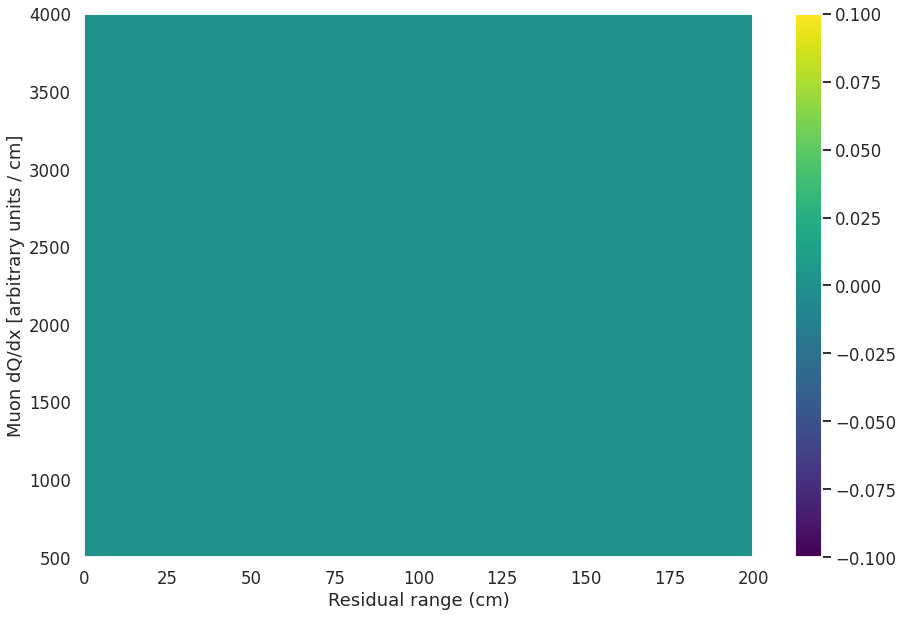

In [31]:
clean = (muons["dx"]*0.3 > 3.5) & (muons["dx"]*0.3 < 50) #& (cells['pca_length']*0.3 > 150)
#clean = np.ones(shape=muons["residual_range"].shape, dtype=np.bool)
plt.hist2d(muons["residual_range"][clean]*0.3, muons["dQ"][clean]/muons["dx"][clean],
          range=[[0, 200], [500, 4000]], bins=[40, 80],
          cmap="viridis")
plt.colorbar()
plt.xlabel("Residual range (cm)")
plt.ylabel("Muon dQ/dx [arbitrary units / cm]")